### Machine Learning with Speech

In [1]:
import os
import time

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
plt.style.use('ggplot')

from sklearn.preprocessing import LabelEncoder, normalize
from sklearn.model_selection import train_test_split

import tensorflow as tf
from tensorflow.keras import layers, Sequential, regularizers
from tensorflow.keras.utils import to_categorical

import IPython.display as ipd
import librosa as lib

import re

Training data was collected from the following sources:

-https://www.kaggle.com/datasets/uwrfkaggler/ravdess-emotional-speech-audio

-https://www.kaggle.com/datasets/ejlok1/cremad

-https://www.kaggle.com/datasets/ejlok1/surrey-audiovisual-expressed-emotion-savee

In [4]:
dir = r'Users/vasantm/speech_emotion_recognition/'
crema = fr'{dir}Crema/'
crema_dict = {'NEU': 'neutral',
           'HAP': 'happy',
           'SAD': 'sad',
           'ANG': 'angry',
           'FEA': 'fearful',
           'DIS': 'disgust',}

ravdess = fr'{dir}/Ravdess/audio_speech_actors_01-24/'
ravdess_dict = {'01':'neutral',
              '02': 'neutral',
              '03': 'happy',
              '04': 'sad',
              '05': 'angry',
              '06': 'fearful',
              '07': 'disgust',
              '08': 'surprised'}

savee = fr'{dir}/Savee/' 
savee_dict = {'a': 'angry',
            'd': 'disgust',
            'f': 'fearful',
            'h': 'happy',
            'n': 'neutral',
            'sa': 'sad',
            'su': 'surprised'}



## RAVDESS


In [5]:
vocal_dict = {'01': 'speech',
             '02':'song'}

intense_dict = {'01': 'normal',
                '02': 'strong'}

emotion_list = []
path_list = []
gender_list = []
vocal_list = []
intense_list = []

ravdess_dir = os.listdir(ravdess)

for i in ravdess_dir:
    actor_files = os.path.join(ravdess, i)
    
    for j in os.listdir(actor_files):
        path = j.split('.')[0]
        
        vocal = path.split('-')[1]
        emotion = path.split('-')[2]
        intense = path.split('-')[3]
    
        
        if emotion in ravdess_dict:
            if vocal in vocal_dict:
                if intense in intense_dict:
                
                    emotion_list.append(ravdess_dict[emotion])
                
                    path_list.append(fr'{ravdess}{i}/{j}')
                
                    vocal_list.append(vocal_dict[vocal])
                    
                    intense_list.append(intense_dict[intense])
                
                    gender = i.split('_')[1]
                    gender_list.append('female' if int(gender) % 2 ==0 else 'male')
            
ravdess_data = pd.DataFrame({'path': path_list,
                             'emotion': emotion_list,
                             'gender': gender_list,
                             'vocal': vocal_list,
                             'intense':intense_list})

ravdess_data = ravdess_data[(ravdess_data['gender'] == 'male') & (ravdess_data['vocal']=='speech') & (ravdess_data['intense'] == 'normal')].reset_index()
ravdess_data = ravdess_data[['path', 'emotion']]
ravdess_data['emotion'].value_counts()

neutral      96
surprised    48
sad          48
fearful      48
angry        48
happy        48
disgust      48
Name: emotion, dtype: int64

## Crema

In [6]:
female_list = [
    '1002', '1003', '1004', '1006', '1007', '1008', '1009', '1010', '1012', '1013', '1018', 
    '1020', '1021', '1024', '1025', '1028', '1029', '1030', '1037', '1043', '1046', '1047', 
    '1049', '1052', '1053', '1054', '1055', '1056', '1058', '1060', '1061', '1063', '1072', 
    '1073', '1074', '1075', '1076', '1078', '1079', '1082', '1084', '1089', '1091',
]

emotion_list = []
path_list = []

actor_files = os.listdir(crema)

for i in actor_files:
    if re.findall('.wav',i):
        emotion = i.split('.')[0].split('_')[2]
        gender = i.split('.')[0].split('_')[0]
        
        if emotion in crema_dict:
            if gender not in female_list:
                emotion_list.append(crema_dict[emotion])
                path_list.append(fr'{crema}/{i}')
                             
crema_data = pd.DataFrame({'path': path_list, 'emotion': emotion_list})
crema_data['emotion'].value_counts()

fearful    671
angry      671
happy      671
disgust    671
sad        671
neutral    575
Name: emotion, dtype: int64

## Savee

In [7]:
actor_files = os.listdir(savee)

for i in actor_files:
    emotion = i.split('.')[0].split('_')[1]
    emotion = ''.join(re.findall(r'[A-Za-z]', emotion))
    
    if emotion in savee_dict:
        emotion_list.append(savee_dict[emotion])
        path_list.append(fr'{savee}/{i}')
                         
savee_data = pd.DataFrame({'path': path_list, 'emotion': emotion_list})
savee_data['emotion'].value_counts()

fearful      731
angry        731
happy        731
disgust      731
sad          731
neutral      695
surprised     60
Name: emotion, dtype: int64

In [8]:
data = pd.concat([ravdess_data, crema_data, savee_data], ignore_index = True, axis = 0)
data['emotion'].value_counts()

fearful      1450
angry        1450
happy        1450
disgust      1450
sad          1450
neutral      1366
surprised     108
Name: emotion, dtype: int64

## Trial Preprocessing

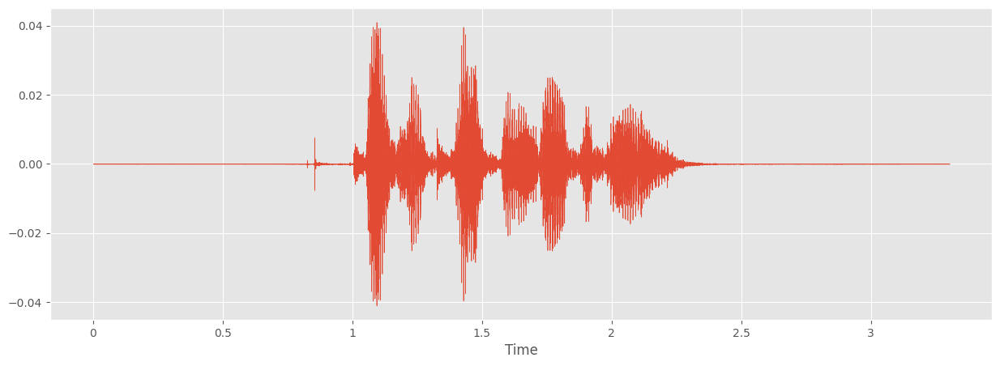

In [9]:
example = data['path'][0] #neutral
sample, sample_rate = lib.load(example)
plt.figure(figsize = (15,5))
lib.display.waveshow(sample, sr = sample_rate)
plt.show()
ipd.Audio(example)

### Resampling

In [10]:
sample_target_rate = 44100

resample = lib.resample(y=sample, orig_sr=sample_rate, target_sr=sample_target_rate)

ipd.Audio(resample, rate = sample_target_rate)

### MEL Spectogram

/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/display.py:1381: MatplotlibDeprecationWarning: SymmetricalLogScale got an unexpected keyword argument 'linthresh'. In the future this will raise TypeError
  scaler(mode, **kwargs)


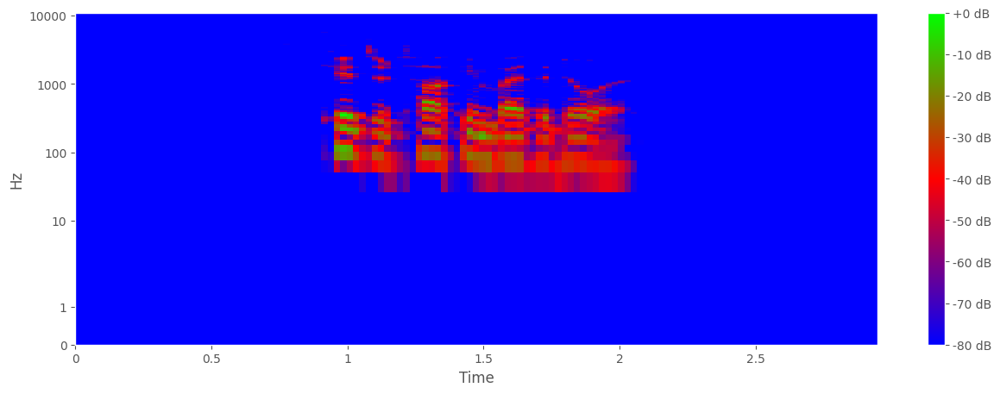

(128, 128)


In [11]:
n_mel = 128
n_fft = 2048 if len(resample) >= 2048 else 1024 if len(resample) >= 1024 else 512 

hop = int(len(resample)/n_mel)

MEL = lib.feature.melspectrogram(y = resample, sr = sample_target_rate, n_fft=n_fft, hop_length=hop)
MEL_DB = lib.amplitude_to_db(MEL, ref = np.max) 

plt.figure(figsize=(15,5))
lib.display.specshow(MEL_DB[:,:128], sr = sample_rate, x_axis = 'time', y_axis = 'mel', cmap = 'brg')
plt.colorbar(format='%+2.0f dB')
plt.show()

print(MEL_DB[:,:128].shape)

### MFCC

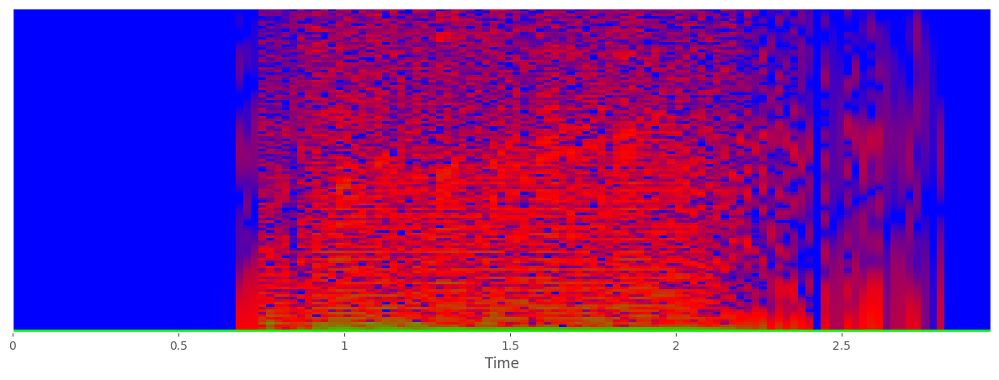

(128, 128)


In [12]:
mfcc = lib.feature.mfcc(y=resample, sr=sample_target_rate, n_mfcc=128, hop_length = hop)
mfcc_DB = lib.amplitude_to_db(mfcc, ref = np.max)


plt.figure(figsize=(15,5))
lib.display.specshow(mfcc_DB[:,:128], sr = sample_rate, x_axis = 'time', cmap = 'brg')
plt.show()

print(mfcc_DB[:,:128].shape)

In [13]:
color_map_func = plt.get_cmap('brg')
color_mfcc = color_map_func(mfcc_DB[:,:128])

color_mfcc_rgb = color_mfcc[:, :, :3]

color_mfcc_rgb.shape

(128, 128, 3)

## Audio Feature

In [13]:
data = data[data['emotion'] != 'surprised'].reset_index(drop = True)

In [14]:
MEL = True

def extract_feat(data_list):
    spec = []
    n_feature = 32
    
    sample_target_rate = 44100
    for j,i in enumerate(data_list): 
        sample, sample_rate = lib.load(i)
        
        resampled_sample = lib.resample(sample, orig_sr=sample_rate, target_sr=sample_target_rate)
        
        hop = int(len(resampled_sample)/n_feature)
        
        n_fft = 2048 if len(resampled_sample) >= 2048 else 1024 if len(resampled_sample) >= 1024 else 512 

        if MEL:
          MEL_samples = lib.feature.melspectrogram(y = resampled_sample, sr = sample_target_rate, hop_length=hop, n_fft=n_fft, n_mels = n_feature)
          MEL_DB = lib.amplitude_to_db(MEL_samples, ref=np.max) 
          feature = MEL_DB[:,:n_feature]
        else:
          mfcc = lib.feature.mfcc(y=resampled_sample, sr=sample_target_rate, n_mfcc=n_feature, n_fft = n_fft,  hop_length=hop)
          mfcc_DB = lib.amplitude_to_db(mfcc, ref = np.max) 
          feature = mfcc_DB[:,:n_feature]
        spec.append(feature)
        print(j)
    return spec
 
x= extract_feat(data['path'])
y = data['emotion']

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [15]:
le = LabelEncoder()
y_le = le.fit_transform(y)

y_encoded = to_categorical(y_le, num_classes=len(data['emotion'].unique()))

def normalize(list):
    x_norm = []
    for i in list:   
        norm = (i-np.min(i))/(np.max(i)-np.min(i))
        color_map_func = plt.get_cmap('brg')
        color_mfcc = color_map_func(norm)  #create a dimension that takes four colors(Red, Blue, Green Alpha)
        color_mfcc_rgb = color_mfcc[:, :, :3] #take the first three colors
        x_norm.append(color_mfcc_rgb)
    return x_norm 


In [16]:
x_norm = normalize(x)

In [17]:
train_x, test_x, train_y, test_y = train_test_split(np.array(x_norm), y_encoded, test_size=0.25, random_state=1000, shuffle=True)
valid_x, test_x, valid_y, test_y = train_test_split(train_x, train_y, test_size=0.75, random_state=1000, shuffle = True)

In [29]:
model = Sequential()
model.add(layers.Conv2D(16, (4,4), activation = 'relu', kernel_regularizer=tf.keras.regularizers.l2(0.01), input_shape = (32,32,3)))
model.add(layers.BatchNormalization(axis = 1))
model.add(layers.MaxPooling2D(pool_size = (2,2)))
model.add(layers.Conv2D(16, (4,4),  activation = 'relu', kernel_regularizer=tf.keras.regularizers.l2(0.01)))
model.add(layers.Flatten())
model.add(layers.Dense(64, activation = 'relu'))
model.add(layers.Dense(len(data['emotion'].unique()), activation = 'softmax'))
    
model.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_10 (Conv2D)           (None, 29, 29, 16)        784       
_________________________________________________________________
batch_normalization_5 (Batch (None, 29, 29, 16)        116       
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 14, 14, 16)        0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 11, 11, 16)        4112      
_________________________________________________________________
flatten_5 (Flatten)          (None, 1936)              0         
_________________________________________________________________
dense_10 (Dense)             (None, 64)                123968    
_________________________________________________________________
dense_11 (Dense)             (None, 6)                

In [30]:
model.compile(loss = 'binary_crossentropy', optimizer = 'Adam', metrics = ['accuracy'])


history = model.fit(train_x,
                    train_y,
                    epochs=11,
                    batch_size=10,
                    validation_data = (valid_x, valid_y))

Epoch 1/11
647/647 [==============================] - 5s 8ms/step - loss: 0.4655 - accuracy: 0.3655 - val_loss: 0.3889 - val_accuracy: 0.4508
Epoch 2/11
647/647 [==============================] - 5s 8ms/step - loss: 0.3894 - accuracy: 0.4537 - val_loss: 0.3598 - val_accuracy: 0.5344
Epoch 3/11
647/647 [==============================] - 5s 8ms/step - loss: 0.3602 - accuracy: 0.5107 - val_loss: 0.3335 - val_accuracy: 0.5715
Epoch 4/11
647/647 [==============================] - 5s 8ms/step - loss: 0.3372 - accuracy: 0.5531 - val_loss: 0.3133 - val_accuracy: 0.5938
Epoch 5/11
647/647 [==============================] - 5s 8ms/step - loss: 0.3128 - accuracy: 0.6049 - val_loss: 0.2702 - val_accuracy: 0.6718
Epoch 6/11
647/647 [==============================] - 5s 8ms/step - loss: 0.2820 - accuracy: 0.6588 - val_loss: 0.2426 - val_accuracy: 0.7257
Epoch 7/11
647/647 [==============================] - 5s 8ms/step - loss: 0.2551 - accuracy: 0.7084 - val_loss: 0.2093 - val_accuracy: 0.7814
Epoch 

In [31]:
model.evaluate(test_x, test_y)

152/152 [==============================] - 1s 5ms/step - loss: 0.1132 - accuracy: 0.9299


[0.11318434029817581, 0.9298534989356995]

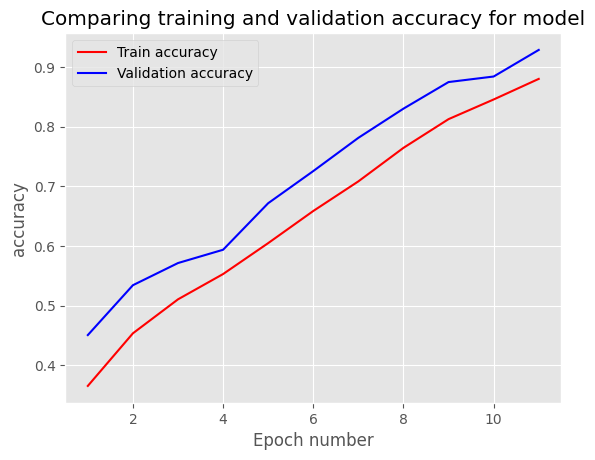

In [33]:
def plotting(model, metric, epoch):
    metrics = model.history[metric]
    val_metrics = history.history['val_' + metric]

    epoch = range(1,epoch+1)
    
    plt.plot(epoch, metrics, 'r', label='Train ' + metric)
    plt.plot(epoch, val_metrics, 'b', label='Validation ' + metric)
    plt.xlabel('Epoch number')
    plt.ylabel(metric)
    plt.title('Comparing training and validation ' + metric + ' for model')
    plt.legend()
    plt.show()
    
plotting(history, 'accuracy', 11)
    

## Classification

In [34]:
speech_data = pd.read_csv(r"Users/vasantm/Pres_data2.csv")
speech_data['path'] = speech_data['path'].str.replace(r'C:\\Users\\magil\\OneDrive\\Documents\\Summer_Project_2023\\Audio\\', r'Users/vasantm/New folder/Audio/')
speech_data.head()

,date,speaker,header,source,summary,transcript,link,path,approval_change(%),disapproval_change(%)
0,2023-02-21,Joe Biden,"February 21, 2023: Remarks on the One-Year Ann...",The White House,"Speaking at the Royal Castle in Warsaw, Poland...","THE PRESIDENT: Hello, Poland! One of our great...",https://dvydlafohk4qa.cloudfront.net/audio/bid...,Users/vasantm/New folder/Audio/February_21_202...,-2.666667,2.0
1,2023-02-07,Joe Biden,"February 7, 2023: State of the Union Address",The White House,"In his State of the Union Address, President J...",Mr. Speaker. Madam Vice President. Our First L...,https://dvydlafohk4qa.cloudfront.net/audio/bid...,Users/vasantm/New folder/Audio/February_7_2023...,1.200000,0.0
2,2022-09-21,Joe Biden,"September 21, 2022: Speech before the 77th Ses...",The White House,President Joe Biden addresses the 77th session...,"Thank you.Mr. President, Mr. Secretary-General...",https://dvydlafohk4qa.cloudfront.net/audio/bid...,Users/vasantm/New folder/Audio/September_21_20...,-0.400000,0.8
3,2022-09-01,Joe Biden,"September 1, 2022: Remarks on the Continued Ba...",The White House,"President Joe Biden speaks in Philadelphia, Pe...","THE PRESIDENT: My fellow Americans, please, if...",https://dvydlafohk4qa.cloudfront.net/audio/bid...,Users/vasantm/New folder/Audio/September_1_202...,0.500000,0.0
4,2022-05-24,Joe Biden,"May 24, 2022: Remarks on School Shooting in Uv...",The White House,President Biden makes an impassioned plea to s...,"Good evening, fellow Americans.I had hoped, wh...",https://dvydlafohk4qa.cloudfront.net/audio/bid...,Users/vasantm/New folder/Audio/May_24_2022_Rem...,-1.000000,0.5


/tmp/ipykernel_6556/1304665318.py:3: UserWarning: PySoundFile failed. Trying audioread instead.
  sample,sample_rate = lib.load(exe)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


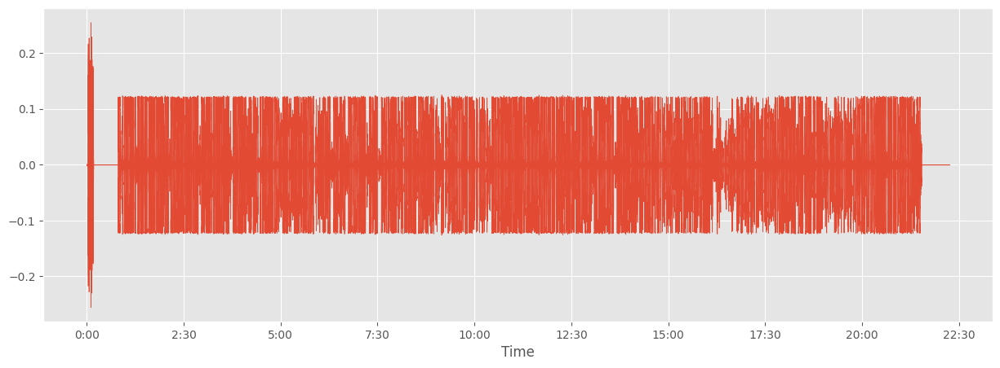

In [65]:
exe = speech_data['path'][0]

sample,sample_rate = lib.load(exe)

plt.figure(figsize = (15,5))
lib.display.waveshow(y = sample, sr = sample_rate)
plt.show()

ipd.Audio(exe)

In [56]:
target_sample_rate = 44100

silence_threshold = 30
min_silence_duration = 0.001
min_silence_duration = int(min_silence_duration * target_sample_rate)

split_sample = lib.effects.split(y=sample, top_db=silence_threshold, frame_length=min_silence_duration)
window_sample = [sample[split_sample[j][0]:split_sample[j][1]] for j in range(split_sample.shape[0])]
window_resample = [lib.resample(y=i, orig_sr=sample_rate, target_sr=target_sample_rate) for i in window_sample]
print(len(window_resample))

3796


[10752 77824]
[207872 228864]


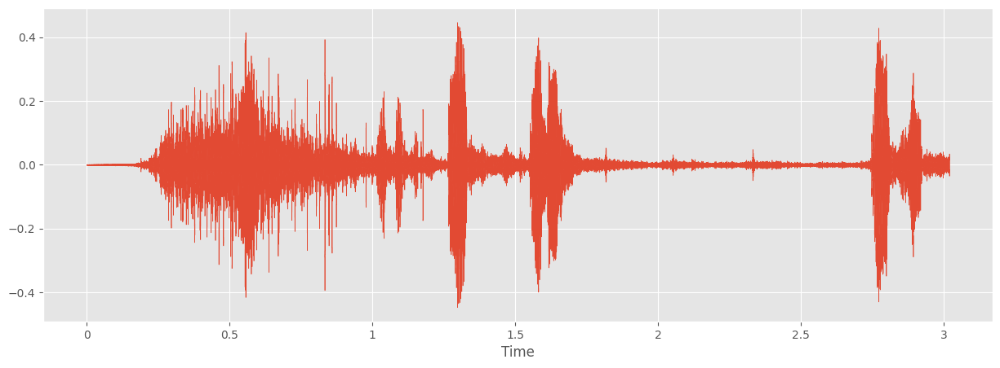

In [72]:
print(split_sample[0])
print(split_sample[3])

plt.figure(figsize = (15,5))
lib.display.waveshow(y = sample[1024:134144], sr = target_sample_rate)
plt.show()

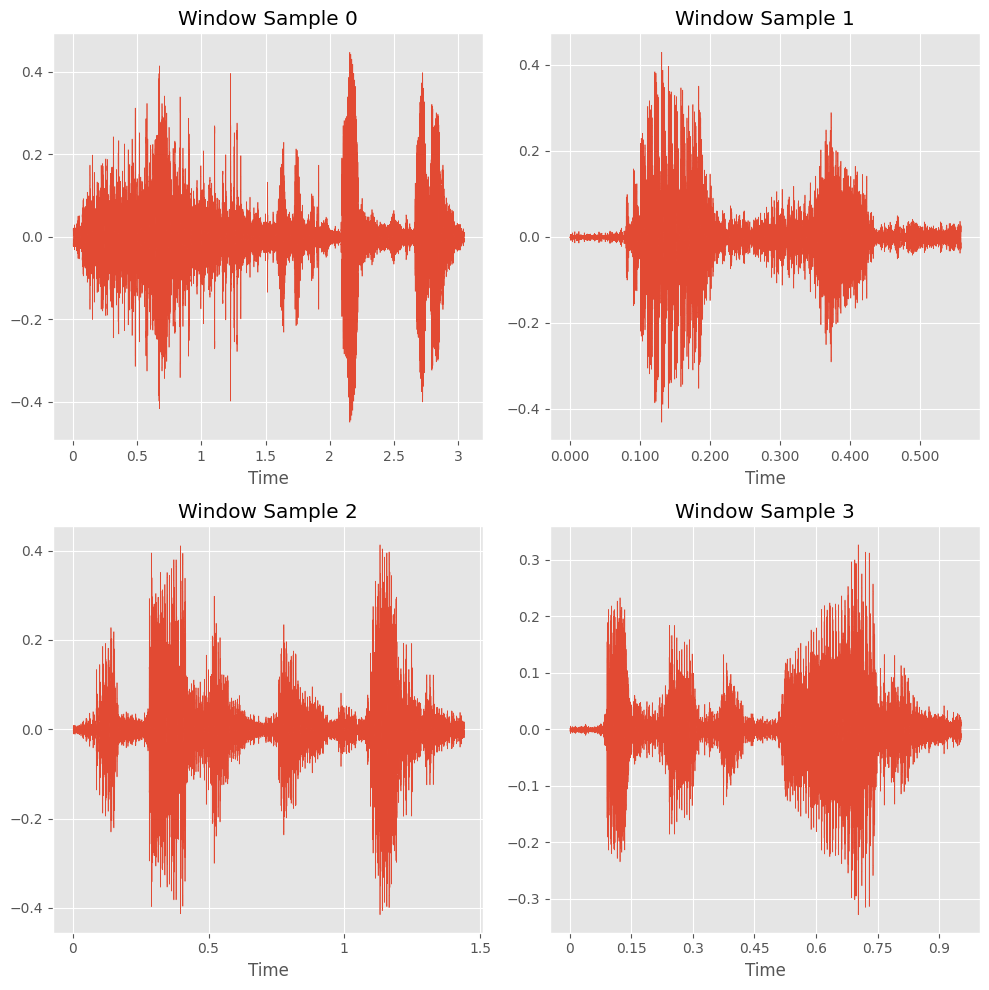

In [73]:
plt.figure(figsize = (10,10))

a = 2
b = 2

for i in range(4):
    plt.subplot(a, b, i+1)
    lib.display.waveshow(y = window_resample[i], sr = target_sample_rate)
    plt.title(f'Window Sample {i}')
    plt.xlabel('Time')
 
plt.tight_layout()
plt.show()   

In [82]:
hop = [int(len(i)/128) for i in window_resample]
            
n_fft = [2048 if len(i) >= 2048 else 1024 if len(i) >= 1024 else 512 for i in window_resample]
      
MEL_samples = [lib.feature.melspectrogram(y=j, sr=target_sample_rate, n_fft=n_fft[i], hop_length = hop[i], n_mels = 128) for i,j in enumerate(window_resample)]
MEL_DB = [lib.amplitude_to_db(i, ref=np.max)[:,:128] for i in MEL_samples]
MEL_DB[1].shape

(128, 128)

In [19]:
len(speech_data['path'])
#:92
#93:184

278

In [57]:
def extract_feat(data_list):
    target_sample_rate = 44100
    n_feature = 32
    feature = []
    path = []
    for j,i in enumerate(data_list): 
        
        try:
            sample, sample_rate = lib.load(i)
        except:
            continue
            
        silence_threshold = 30
        min_silence_duration = 0.001
        min_silence_frames = int(min_silence_duration * target_sample_rate)
        split_sample = lib.effects.split(sample, top_db=silence_threshold, frame_length=min_silence_frames)
        window_sample = [sample[split_sample[j][0]:split_sample[j][1]] for j in range(split_sample.shape[0])]
        window_resample = [lib.resample(i, orig_sr=sample_rate, target_sr=target_sample_rate) for i in window_sample]
            
        hop = [int(len(i)/n_feature) for i in window_resample]
            
        n_fft = [2048 if len(i) >= 2048 else 1024 if len(i) >= 1024 else 512 for i in window_resample]

            
        MEL_samples = [lib.feature.melspectrogram(y=j, sr=target_sample_rate, n_fft=n_fft[i], hop_length = hop[i], n_mels = n_feature) for i,j in enumerate(window_resample)]
        MEL_DB = [lib.amplitude_to_db(i, ref=np.max)[:,:n_feature] for i in MEL_samples]
        feature.append(normalize(MEL_DB))
        path.append(speech_data['path'][j])
        
        
        print(j)
        time.sleep(2)
    return feature, path
        
x_feature1,y_feature1 = extract_feat(speech_data['path'])

/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


0


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


1


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


2


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


3


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


4


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


5


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


6


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


7


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


8


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


9


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


10


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


11


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


12


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


13


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


14


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


15


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


16


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


17


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


18


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


19


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


20


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


21


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


22


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


23


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


24


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


25


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


26


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


27


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


28


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


29


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


30


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


31


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


32


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


33


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


34


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


35


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


36


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


37


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


38


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


39


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


40


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


41


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


42


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


43


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


44


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


45


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


46


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


47


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


48


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


49


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


50


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


51


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


52


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


53


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


54


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


55


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


56


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


57


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


58


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


59


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


60


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


61


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


62


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


63


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


64


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


65


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


66


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


67


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


68


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


69


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


70


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


71


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


72


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


73


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


74


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


75


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


76


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


77


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


78


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


79


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


80


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


81


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


82


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


83


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


84


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


85


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


86


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


87


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


88


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


89


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


90


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


91


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


92


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


93


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


94


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


95


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


96


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


97


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


98


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


99


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


100


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


101


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


102


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


103


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


104


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


105


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


106


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


107


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


108


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


109


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


110


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


111


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


112


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


113


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


114


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


115


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


116


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


117


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


118


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


119


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


120


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


121


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


122


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


123


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


124


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


125


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


126


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


127


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


128


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


129


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


130


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


131


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


132


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


133


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


134


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


135


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


136


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


137


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


138


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


139


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


140


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


141


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


142


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


143


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


144


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


145


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


146


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


147


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


148


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


149


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


150


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


151


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


152


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


153


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


154


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


155


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


156


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


157


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


158


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


159


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


160


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


161


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


162


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


163


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


164


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


165


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


166


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


167


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


168


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


169


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


170


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


171


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


172


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


173


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


174


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


175


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


176


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


177


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


178


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


179


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


180


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


181


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


182


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


183


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


184


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


185


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


186


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


187


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


188


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


189


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


190


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


191


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


192


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


193


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


194


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


195


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


196


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


197


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


198


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


199


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


200


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


201


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


202


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


203


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


204


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


205


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


206


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


207


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


208


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


209


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


210


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


211


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


212


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


213


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


214


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


215


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


216


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


217


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


218


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


219


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


220


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


221


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


222


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


223


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


224


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


225


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


226


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


227


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


228


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


229


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


230


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


231


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


232


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


233


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


234


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


235


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


236


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


237


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


238


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


239


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


240


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


241


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


242


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


243


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


244


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


245


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


246


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


247


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


248


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


249


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


250


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


251


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


252


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


253


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


254


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


255


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


256


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


257


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


258


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


259


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


260


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


261


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


262


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


263


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


264


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


265


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


266


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


267


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


268


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


269


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


270


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


271


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


272


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


273


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


274


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


275


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


276


/tmp/ipykernel_6556/4243167631.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  sample, sample_rate = lib.load(i)
/anaconda/envs/azureml_py38/lib/python3.8/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


277


In [60]:
def classification(x, model = model, classes = classes):
    labels = []
    for index,feature in enumerate(x):
        label = [classes[np.argmax(model.predict(np.expand_dims(i, axis = 0)))] for i in feature]
        labels.append(label)
        print(index)
        time.sleep(2)
    return labels

In [66]:
x_label1 = classification(x_feature1)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222


Bad pipe message: %s [b'\xd6\x02A\x81\x93\xce\x83\xec"{\x07\x0e\'\xbb\xb0C\xed\xf6 \xb1p\x81\xba\xbbD\xa0.o(\xca\x1c\x03h\x89\x1e\x95\x84\xc4~\xd8r/!\xa3d\xf1_\xec\xde\x04M\x00\x08\x13\x02\x13\x03\x13\x01\x00\xff\x01\x00\x00\x8f']
Bad pipe message: %s [b'|\x05\xdc\xb9!CQ\xb7\xb2!\xcbI\xe9\xa9\xfe\x1a+$\x00\x00|\xc0,\xc00\x00']
Bad pipe message: %s [b"\x9f\xcc\xa9\xcc\xa8\xcc\xaa\xc0\xaf\xc0\xad\xc0\xa3\xc0\x9f\xc0]\xc0a\xc0W\xc0S\xc0+\xc0/\x00\xa2\x00\x9e\xc0\xae\xc0\xac\xc0\xa2\xc0\x9e\xc0\\\xc0`\xc0V\xc0R\xc0$\xc0(\x00k\x00j\xc0#\xc0'\x00g\x00@\xc0\n\xc0\x14\x009\x008\xc0\t\xc0\x13\x003\x002\x00\x9d\xc0\xa1\xc0\x9d\xc0Q\x00\x9c\xc0\xa0\xc0\x9c\xc0P\x00=\x00<\x005\x00/\x00\x9a\x00\x99\xc0\x07\xc0\x11\x00\x96\x00\x05\x00\xff\x01\x00\x00j\x00\x00\x00\x0e\x00\x0c\x00\x00\t127.0.0.1\x00\x0b\x00\x04\x03\x00\x01\x02\x00\n\x00\x0c\x00\n\x00\x1d\x00\x17\x00\x1e\x00\x19\x00"]
Bad pipe message: %s [b'#\x00\x00\x00\x16\x00\x00\x00\x17\x00\x00\x00\r\x000\x00.\x04\x03\x05\x03\x06\x03']
Bad pipe me

223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


In [68]:
audio_data1 = pd.DataFrame({'path':y_feature1, 'feature': x_label1})
audio_data1.to_csv('Users/vasantm/emotional_speech.csv', index = False)